
# Computer Vision Project
**Done by**: Ahmed Ali & Sohaila Hussein

**Professor**: Adil Khan

**TA**: Karam

# Environment Setup

## Downloading the models
The YOLO V3 and YOLO comlex models v3 were uploaded in a google drive to easily get them every time.

In [1]:
!pip install --upgrade --no-cache-dir gdown

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for gdown: filename=gdown-4.4.0-py3-none-any.whl size=14774 sha256=039ec3a16ad582e781951cca1cf0d83012f5e0b543d4af87d1bf2327f316549d
  Stored in directory: /tmp/pip-ephem-wheel-cache-unefn7v9/wheels/fb/c3/0e/c4d8ff8bfcb0461afff199471449f642179b74968c15b7a69c
Successfully built gdown
  Attempting uninstall: gdown
    Found existing installation: gdown 4.2.2
    Uninstalling gdown-4.2.2:
      Successfully uninstalled gdown-4.2.2


In [2]:
!gdown     https://drive.google.com/uc?id=1scrOfxjJV_a0xQsbw-dnuRjHO953cW9s

Downloading...
From: https://drive.google.com/uc?id=1scrOfxjJV_a0xQsbw-dnuRjHO953cW9s
To: /content/YoloV3_and_Complex3.rar
100% 1.40G/1.40G [00:24<00:00, 57.4MB/s]


## Directories

We here create some directories to be in the same structure as our google drive. We did so to make code more flexible (code work with mounting drive or dowloaindg from the drive)

In [3]:
!mkdir /content/drive
!mkdir /content/drive/MyDrive

# #unzip the model inside myDrive folder
!unrar x /content/YoloV3_and_Complex3.rar -d /content/drive/MyDrive


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/YoloV3_and_Complex3.rar

Creating    /content/drive/MyDrive/Complex-YOLOv3                     OK
Creating    /content/drive/MyDrive/Complex-YOLOv3/.git                OK
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/config              0%  OK 
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/description         0%  OK 
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/HEAD                0%  OK 
Creating    /content/drive/MyDrive/Complex-YOLOv3/.git/hooks          OK
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/hooks/applypatch-msg.sample       0%  OK 
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/hooks/commit-msg.sample       0%  OK 
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/hooks/fsmonitor-watchman.sample       0%  OK 
Extracting  /content/drive/MyDrive/Complex-YOLOv3/.git/hooks/post-up

# Visualizing Lidar Data

In [4]:
#go to the complex yolo directory
%cd /content/drive/MyDrive/Complex-YOLOv3

/content/drive/MyDrive/Complex-YOLOv3


Here we display the lidar data from one of the kittidataset point clouds.

In [5]:
from utils.kitti_dataset import KittiDataset as kitti

obj=kitti("/content/drive/MyDrive/Complex-YOLOv3/data/KITTI/object/sampledata")
lidar_PC=obj.get_lidar(1)
print(lidar_PC.shape)

(120268, 4)


In [6]:
from mpl_toolkits import mplot3d
import numpy as np
import plotly.graph_objects as plt
import cvxpy as cp  
from random import random
import math

#draw poitn cloud as 3d points scatter plot
fig = plt.Figure(data=[plt.Scatter3d(x=lidar_PC[:,0], y=lidar_PC[:,1], z=lidar_PC[:,2],
                                   mode='markers',marker = dict(
                                     size = 1,
                                     opacity = 0.5
                                   ))])


fig.update_layout(scene = dict(
                    xaxis = dict(
                         backgroundcolor="rgb(200, 200, 230)",   #color for  background
                         range=[min(lidar_PC[:,0]),max(lidar_PC[:,0])], #range
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="green",),
                    yaxis = dict(
                        backgroundcolor="rgb(230, 200,230)",
                        range=[min(lidar_PC[:,1]),max(lidar_PC[:,1])],
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="blue"),
                    zaxis = dict(
                        backgroundcolor="rgb(230, 230,200)",
                        range=[-60,60], #this to enlarge the graph so we better visualization for the data
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="red"),)
                  )

fig.show()

# Preprocessing

Converting the image into bird eye view image (BEV)

In [7]:
import numpy as np
def makeBVFeature(PointCloud_,bc):

    Height = 609
    Width =  609

   
    PointCloud = np.copy(PointCloud_)

    # cropping the point cloud into the prefered area 
    indeces = np.where((PointCloud[:, 0] >= bc['minX']) & (PointCloud[:, 0] <= bc['maxX']) & (PointCloud[:, 1] >= bc['minY']) & (
            PointCloud[:, 1] <= bc['maxY']) & (PointCloud[:, 2] >= bc['minZ']) & (PointCloud[:, 2] <= bc['maxZ']))
    PointCloud = PointCloud[indeces]
    
    # Discretize Feature Map
    Discretization = (bc["maxX"] - bc["minX"])/(Height-1)  

    PointCloud[:, 0] = np.int_(np.floor(PointCloud[:, 0] / Discretization))  #map xdistnce to pixel value
    PointCloud[:, 1] = np.int_(np.floor(PointCloud[:, 1] / Discretization) + Width / 2)  #map ydistnce to pixel value , convert negative values into postive
   
    # sort-3times
    #negative z to get the maximum z instead of minimum
    indices = np.lexsort((-PointCloud[:, 2], PointCloud[:, 1], PointCloud[:, 0]))
    PointCloud = PointCloud[indices]

    # Height Map
    heightMap = np.zeros((Height, Width))

    _, indices = np.unique(PointCloud[:, 0:2], axis=0, return_index=True)
    PointCloud_frac = PointCloud[indices]
    # some important problem is image coordinate is (y,x), not (x,y)
    max_height = float(np.abs(bc['maxZ'] - bc['minZ']))
    #normalized z coordinate
    heightMap[np.int_(PointCloud_frac[:, 0]), np.int_(PointCloud_frac[:, 1])] = PointCloud_frac[:, 2] / max_height

    # Intensity Map & DensityMap
    intensityMap = np.zeros((Height, Width))
    densityMap = np.zeros((Height, Width))

    _, indices, counts = np.unique(PointCloud[:, 0:2], axis=0, return_index=True, return_counts=True)
    PointCloud_top = PointCloud[indices]

    normalizedCounts = np.minimum(1.0, np.log(counts + 1) / np.log(64))

   #put the index 3 from lidar data as intensity map
    intensityMap[np.int_(PointCloud_top[:, 0]), np.int_(PointCloud_top[:, 1])] = PointCloud_top[:, 3]
    densityMap[np.int_(PointCloud_top[:, 0]), np.int_(PointCloud_top[:, 1])] = normalizedCounts

    #creating the rgb image
    RGB_Map = np.zeros(( Height - 1, Width - 1,3))
    RGB_Map[:, :, 2] = densityMap[:608, :608]  # r_map
    RGB_Map[:, :, 1] = heightMap[:608, :608]  # g_map
    RGB_Map[:, :, 0] = intensityMap[:608, :608]  # b_map
    RGB_Map *= 255
    RGB_Map = RGB_Map.astype(np.uint8)

    return RGB_Map

Display the generated BEV image

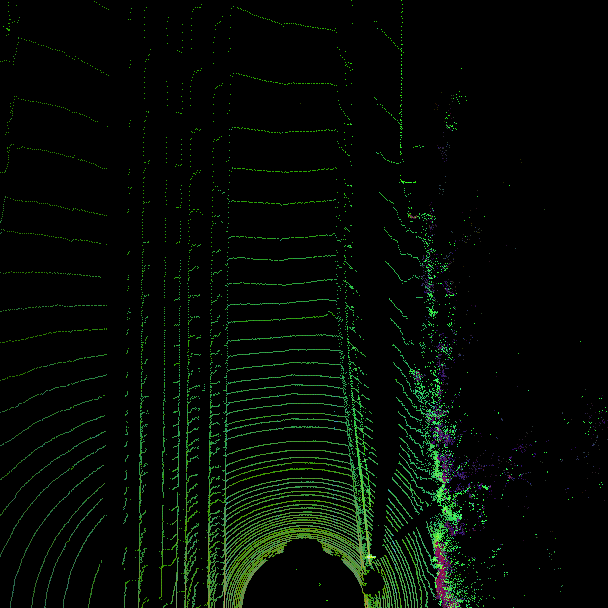

In [8]:
import cv2
from IPython import display
import PIL
def show_image(img,rotate=False):
  
  if not rotate:
    img= img.clip(0, 255).astype('uint8')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    display.display(PIL.Image.fromarray(img))
  else:
    img= img.clip(0, 255).astype('uint8')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.rotate(img, cv2.ROTATE_180)
    display.display(PIL.Image.fromarray(img))


bc = {
    "minX": 0,
    "maxX": 40,
    "minY": -20,
    "maxY": 20,
    "minZ": -2.73,
    "maxZ": 1.27
}
BEV_sample=makeBVFeature(lidar_PC, bc)
show_image(BEV_sample,rotate=True)

# YoloV3 Model (Testing)

In [9]:
%cd /content/drive/MyDrive/PyTorch-YOLOv3-kitti
!pip install -r requirements.txt

/content/drive/MyDrive/PyTorch-YOLOv3-kitti
     |████████████████████████████████| 676 kB 4.3 MB/s 
     |████████████████████████████████| 54 kB 2.7 MB/s 
  Created wheel for visdom: filename=visdom-0.1.8.9-py3-none-any.whl size=655250 sha256=86bd92816c802212fc12560bd5e9c0a699d5581816dfd18ac61a037d107796df
  Stored in directory: /root/.cache/pip/wheels/2d/d1/9b/cde923274eac9cbb6ff0d8c7c72fe30a3da9095a38fd50bbf1
  Created wheel for torchfile: filename=torchfile-0.1.0-py3-none-any.whl size=5709 sha256=ae5da77a6c4bf7b0b71507e5440e0d4ce6ff6707eece1ce125d0011e380cd9ea
  Stored in directory: /root/.cache/pip/wheels/ac/5c/3a/a80e1c65880945c71fd833408cd1e9a8cb7e2f8f37620bb75b
Successfully built visdom torchfile


In [10]:
!python detect.py

Config:
Namespace(batch_size=10, class_path='data/kitti.names', conf_thres=0.8, config_path='config/yolov3-kitti.cfg', image_folder='data/samples/', img_size=416, n_cpu=8, nms_thres=0.4, use_cuda=True, weights_path='weights/yolov3-kitti.weights')
/usr/local/lib/python3.7/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))
model path: weights/yolov3-kitti.weights
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
data size : 12

Performing object detection:
	+ Batch 

#Yolo Complex Model (Testing)

## YOLO-Complex 3D model requirments

In [11]:
%cd /content/drive/MyDrive/Complex-YOLOv3
!pip install -r requirements.txt
!pip3 install vtk==8.1.2
!pip3 install mayavi

/content/drive/MyDrive/Complex-YOLOv3
     |████████████████████████████████| 676.9 MB 3.7 kB/s 
     |████████████████████████████████| 23.2 MB 63.1 MB/s 
     |████████████████████████████████| 23.3 MB 56.4 MB/s 
     |████████████████████████████████| 23.3 MB 58.2 MB/s 
     |████████████████████████████████| 22.1 MB 1.2 MB/s 
     |████████████████████████████████| 22.1 MB 24.0 MB/s 
     |████████████████████████████████| 17.4 MB 560 kB/s 
     |████████████████████████████████| 17.3 MB 45.8 MB/s 
     |████████████████████████████████| 12.8 MB 39.4 MB/s 
     |████████████████████████████████| 12.7 MB 39.6 MB/s 
     |████████████████████████████████| 11.8 MB 174 kB/s 
     |████████████████████████████████| 5.9 MB 34.3 MB/s 
     |████████████████████████████████| 6.6 MB 30.0 MB/s 
     |████████████████████████████████| 6.6 MB 46.9 MB/s 
     |████████████████████████████████| 4.0 MB 33.0 MB/s 
     |████████████████████████████████| 10.2 MB 41.4 MB/s 
     |███████████████████

     |████████████████████████████████| 48.9 MB 1.3 MB/s 
     |████████████████████████████████| 7.1 MB 3.5 MB/s 
     |████████████████████████████████| 177 kB 39.6 MB/s 
     |████████████████████████████████| 194 kB 43.2 MB/s 
     |████████████████████████████████| 1.3 MB 50.2 MB/s 
     |████████████████████████████████| 5.1 MB 23.8 MB/s 
     |████████████████████████████████| 6.7 MB 20.9 MB/s 
  Created wheel for mayavi: filename=mayavi-4.7.4-cp37-cp37m-linux_x86_64.whl size=13313875 sha256=d678066056046b0235d605ad48d5f053f48dc30a45b4f12e00a8da0ac54cfb2e
  Stored in directory: /root/.cache/pip/wheels/6e/57/a6/087ccc194de1ef1b2975c0c5c2348423b372da06de1aee8bea
  Created wheel for traitsui: filename=traitsui-7.2.1-py3-none-any.whl size=1485989 sha256=afab6caa5bceac4a237f6f93a1e41673cd43da4424650c6697446e0fd7084e54
  Stored in directory: /root/.cache/pip/wheels/de/d2/e1/7fabe0067f5f5d11fff725170f52f27ba02962ac74f027d628
  Created wheel for apptools: filename=apptools-5.1.0-py3-non

In [12]:
!python test_detection.py --model_def '/content/drive/MyDrive/Complex-YOLOv3/config/complex_yolov3.cfg' --weights_path  "checkpoints/yolov3_ckpt_epoch-298.pth" --split=sample --folder=sampledata


/usr/local/lib/python3.7/dist-packages/traits/etsconfig/etsconfig.py:412: UserWarning: Environment variable "HOME" not set, setting home directory to /tmp
  % (environment_variable, parent_directory)
Namespace(class_path='data/classes.names', conf_thres=0.5, folder='sampledata', img_size=608, model_def='/content/drive/MyDrive/Complex-YOLOv3/config/complex_yolov3.cfg', nms_thres=0.5, split='sample', weights_path='checkpoints/yolov3_ckpt_epoch-298.pth')
Load TEST samples from /content/drive/MyDrive/Complex-YOLOv3/data/KITTI/object/sampledata
Done: total TEST samples 117
-----------start reading------------
image number :   0
FPS: 0.17
pts_3d.shape :  (20285, 3)
pts_2d.shape :  (20285, 2)
img2d.shape :  (370, 1224, 3)
452880
-----------start reading------------
image number :   1
FPS: 0.21
pts_3d.shape :  (18630, 3)
pts_2d.shape :  (18630, 2)
img2d.shape :  (375, 1242, 3)
465750
-----------start reading------------
image number :   2
FPS: 0.26
pts_3d.shape :  (20210, 3)
pts_2d.shape :  (2

In [13]:
!python test_both_side_detection.py --model_def '/content/drive/MyDrive/Complex-YOLOv3/config/complex_yolov3.cfg' --weights_path  "checkpoints/yolov3_ckpt_epoch-298.pth" --split=sample --folder=sampledata

/usr/local/lib/python3.7/dist-packages/traits/etsconfig/etsconfig.py:412: UserWarning: Environment variable "HOME" not set, setting home directory to /tmp
  % (environment_variable, parent_directory)
Namespace(class_path='data/classes.names', conf_thres=0.8, folder='sampledata', img_size=608, model_def='/content/drive/MyDrive/Complex-YOLOv3/config/complex_yolov3.cfg', nms_thres=0.4, save_video=False, split='sample', weights_path='checkpoints/yolov3_ckpt_epoch-298.pth')
Load TESTING samples from /content/drive/MyDrive/Complex-YOLOv3/data/KITTI/object/sampledata
Done: total TESTING samples 117
FPS: 0.10
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.14
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
FPS: 0.15
F

#Results

## Results of Yolo Complex on BEV images

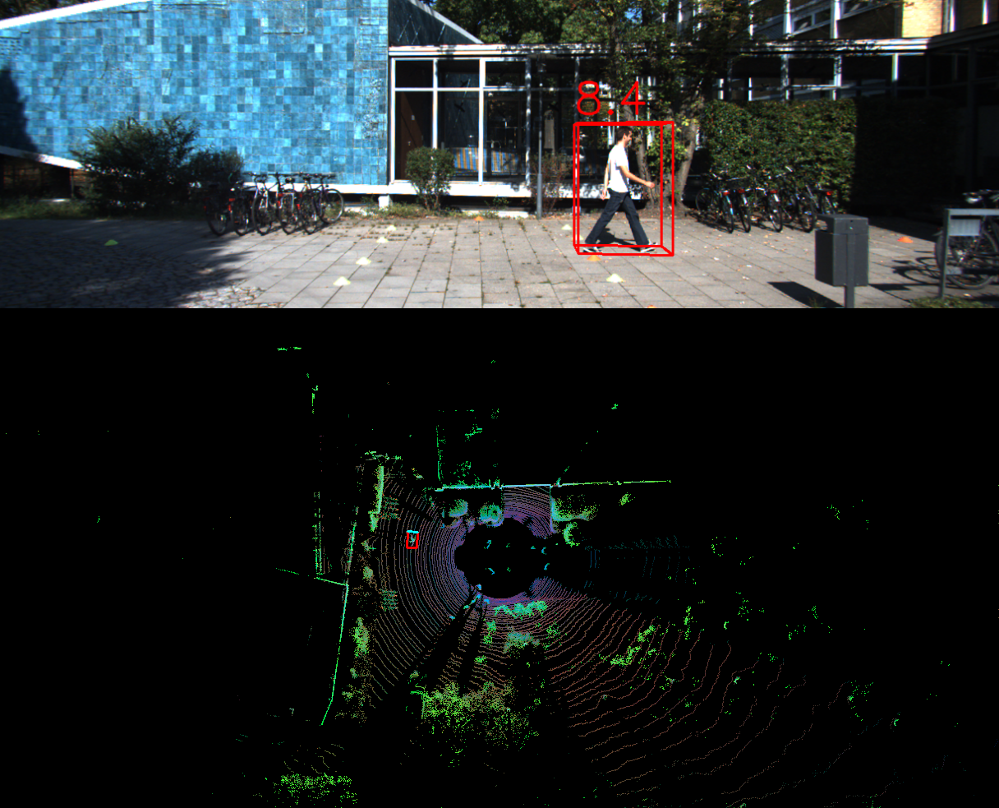

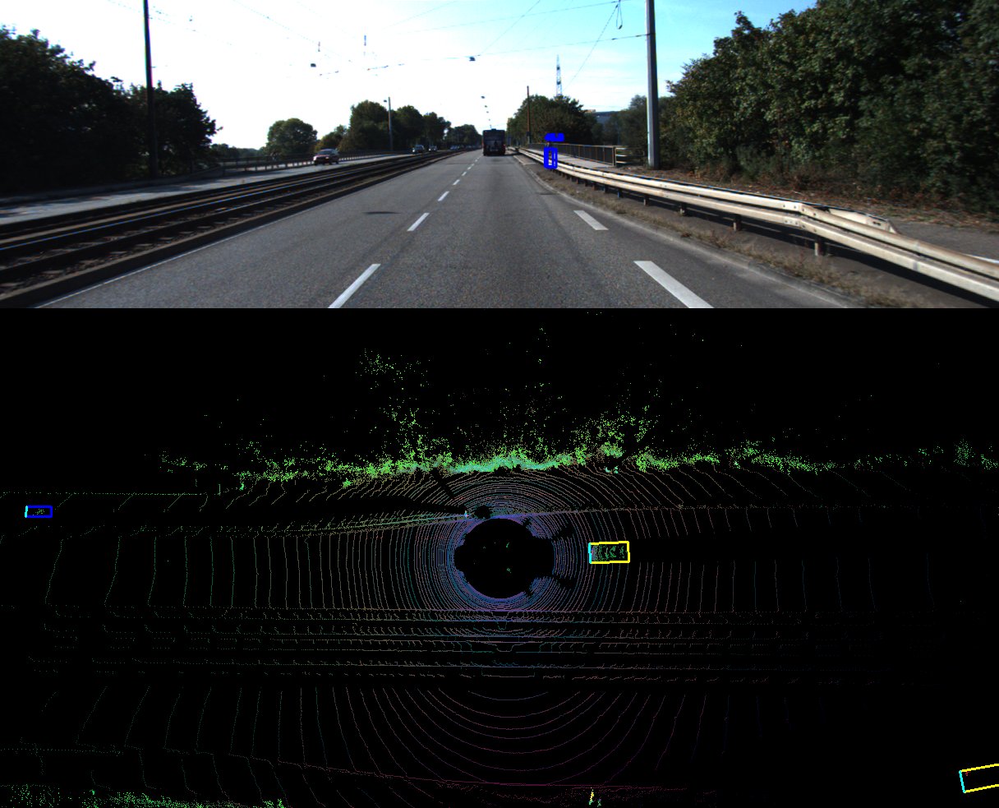

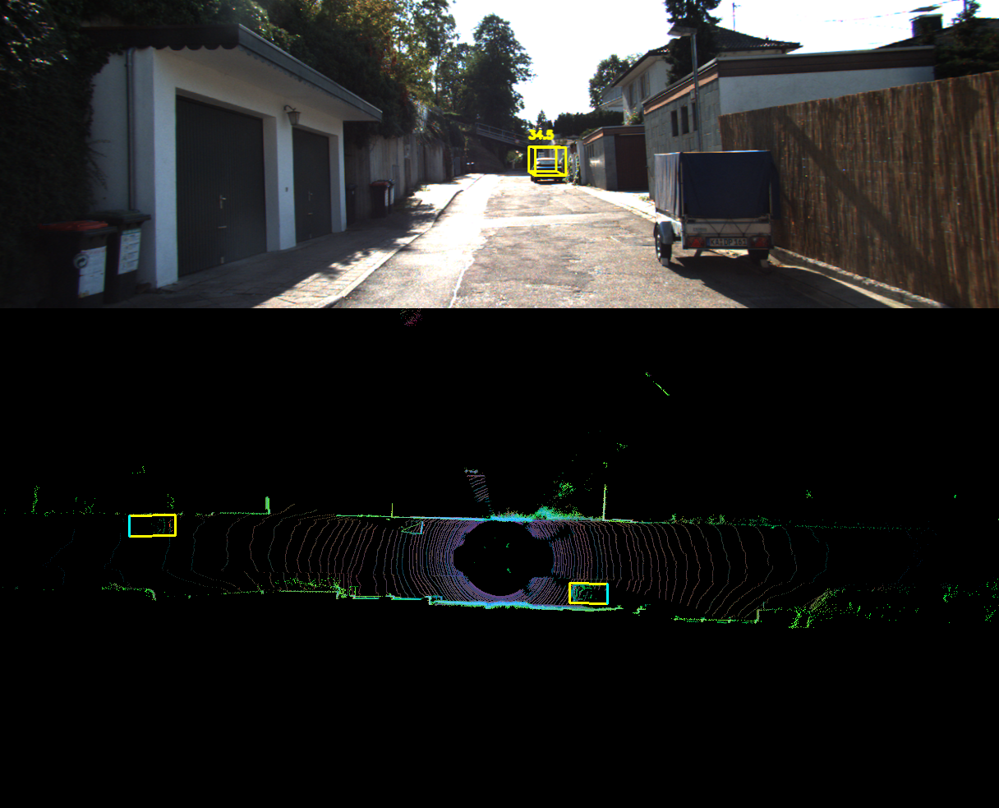

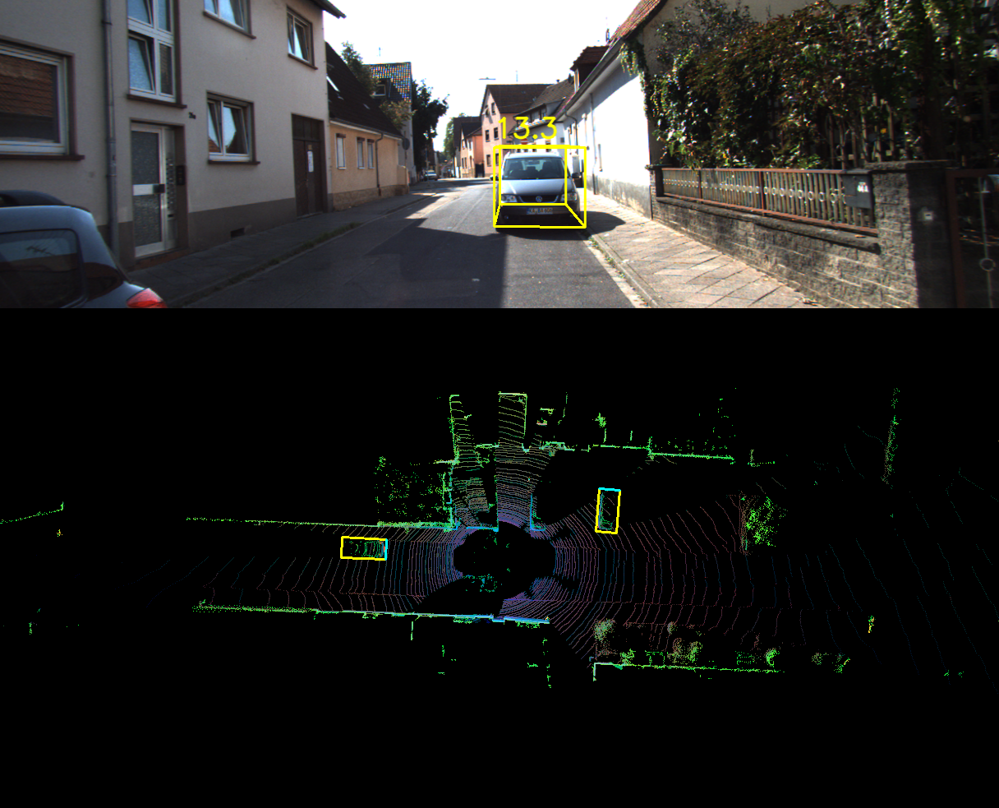

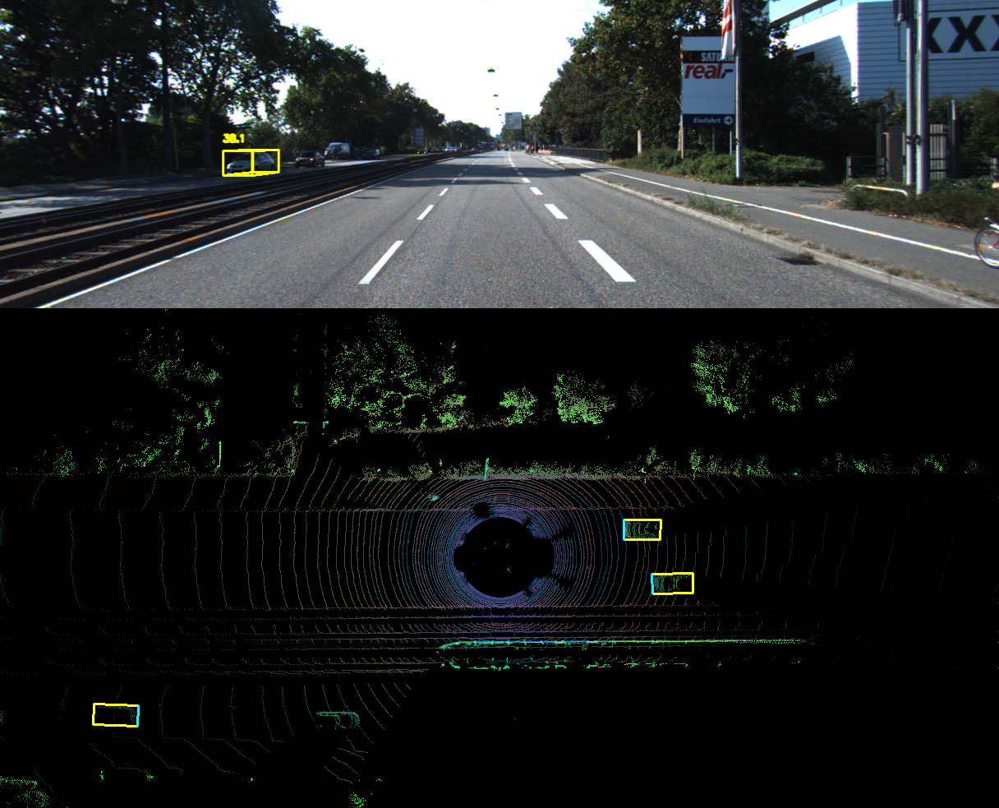

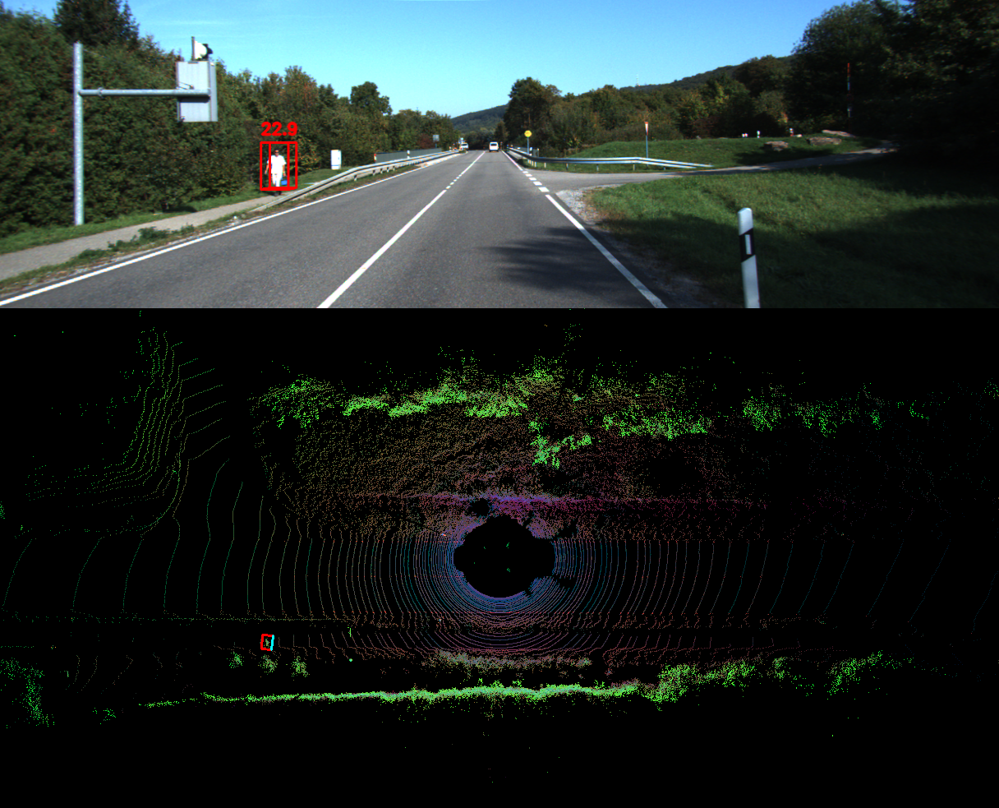

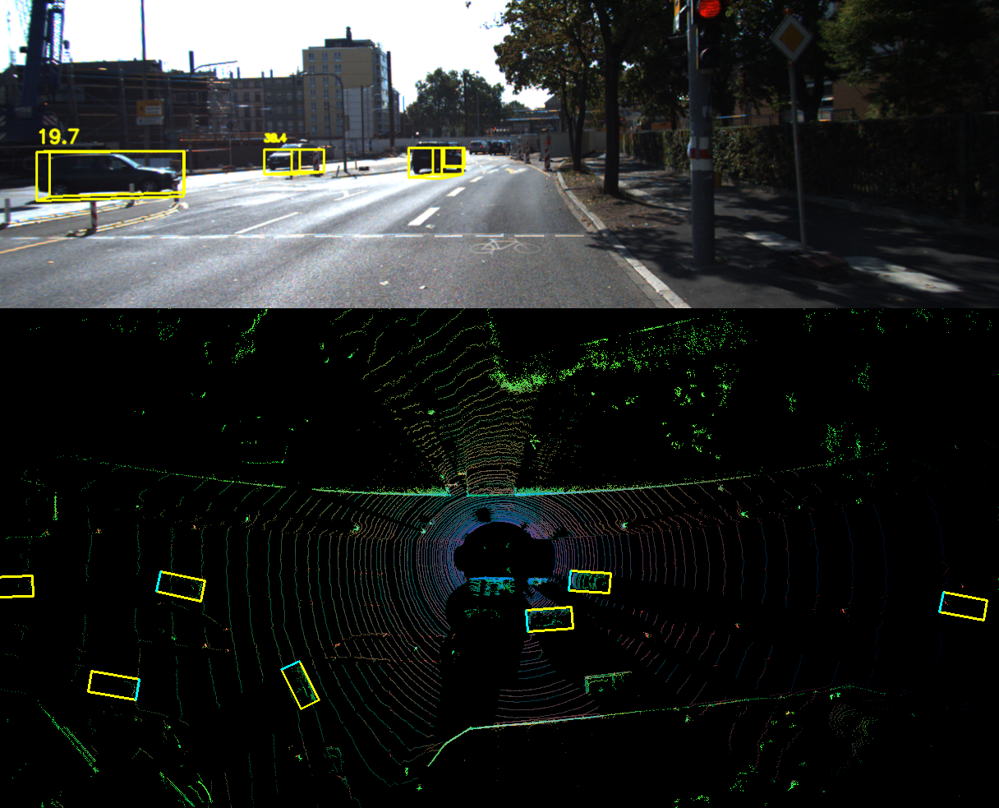

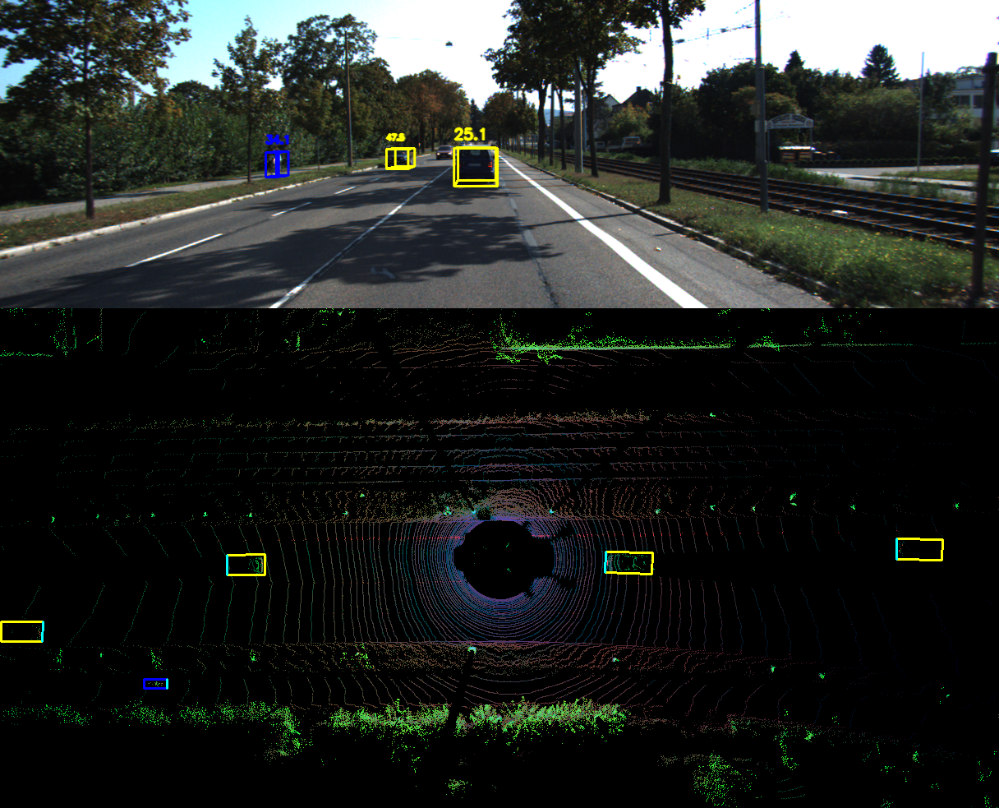

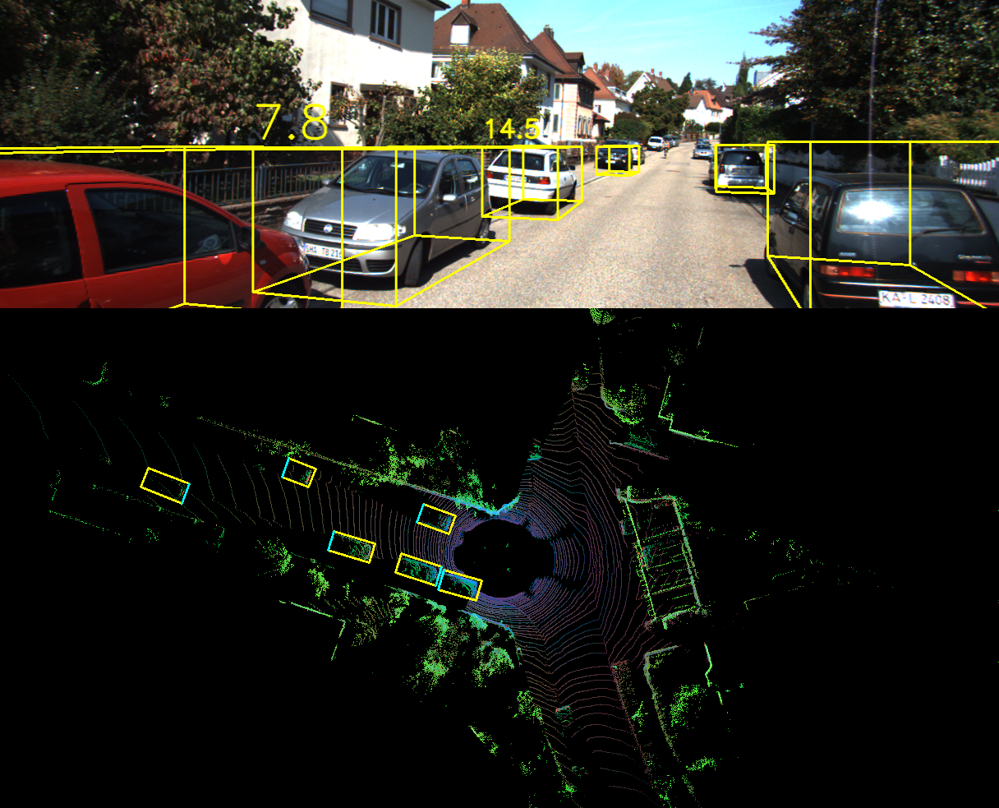

In [14]:
from google.colab.patches import cv2_imshow
#change the range to display the test images 
for i in range(1,10):
  j = str(i)
  img1= cv2.imread("BEV_DETECTION_RESULT"+j+".png")
  cv2_imshow(img1)

## Results of combined YOLO3 with YOLO3 Complex 

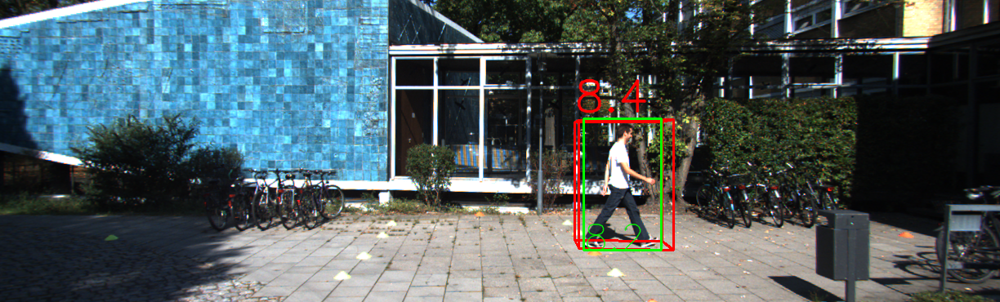

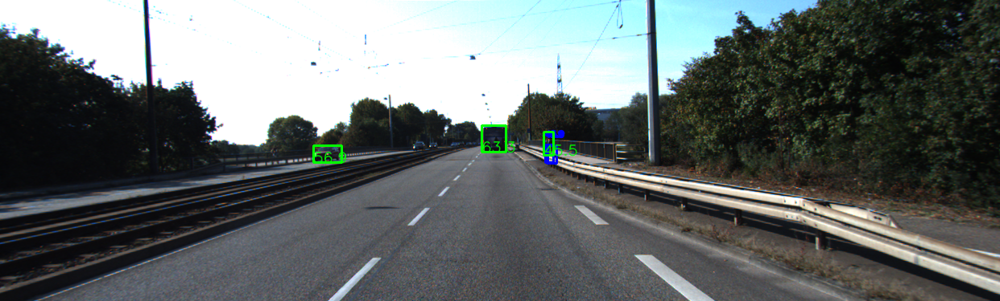

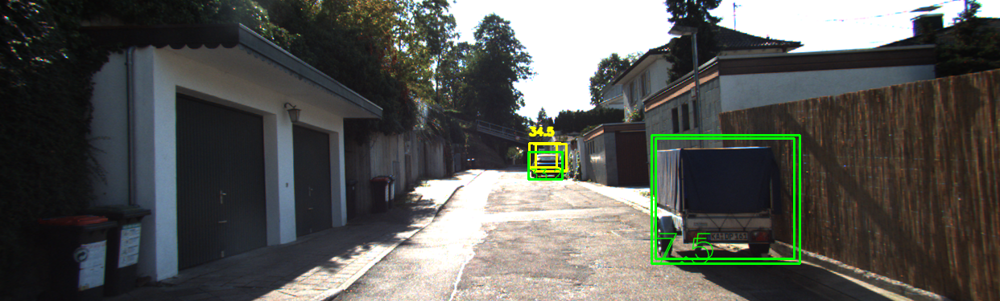

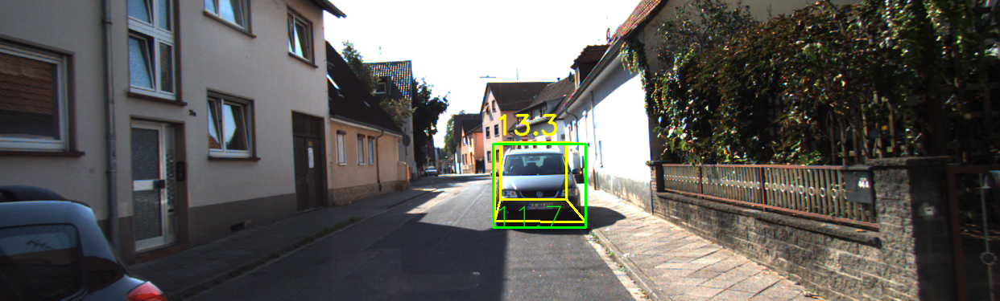

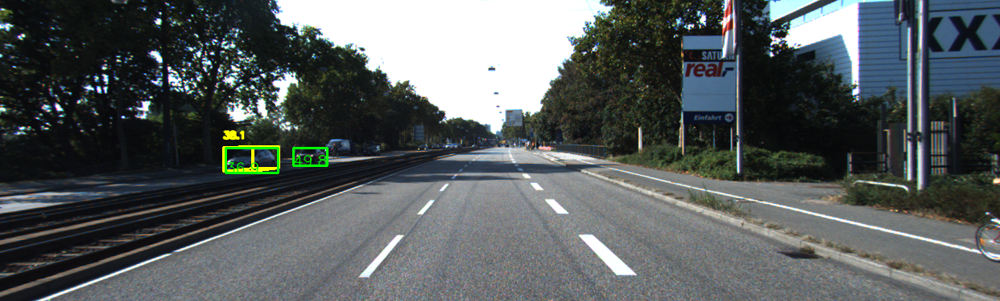

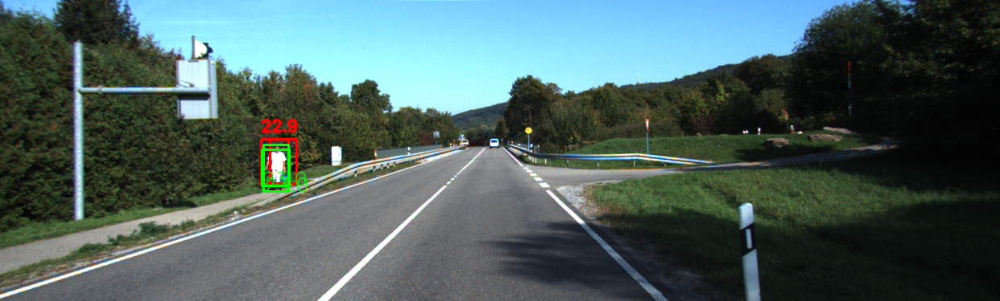

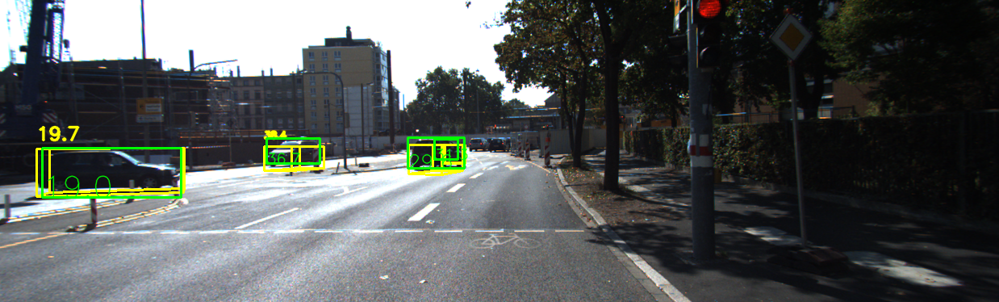

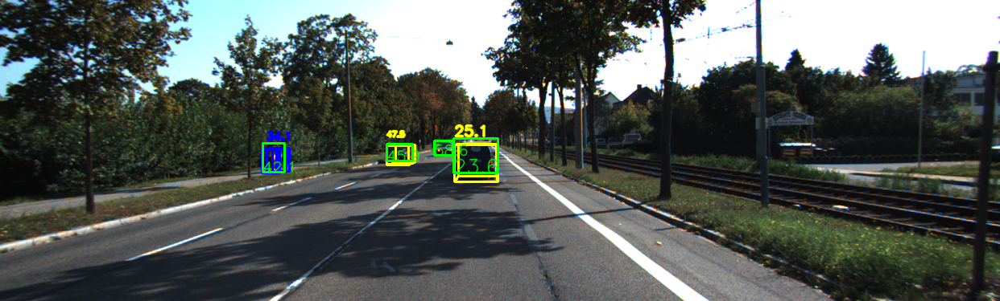

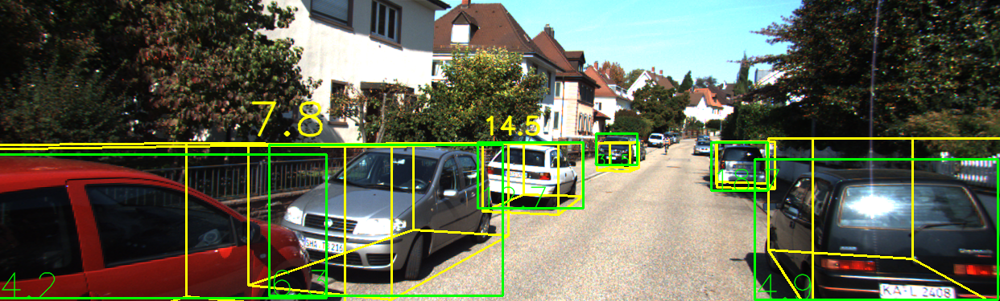

In [15]:

for i in range(1,10):
  j = str(i)
  img1= cv2.imread("img2d"+j+".png")

  cv2_imshow(img1)



# Metric Evaluation

In [16]:
!python eval_mAP.py 

Namespace(batch_size=10, class_path='data/classes.names', conf_thres=0.5, img_size=608, iou_thres=0.5, model_def='config/complex_tiny_yolov3.cfg', nms_thres=0.5, weights_path='checkpoints/tiny-yolov3_ckpt_epoch-220.pth')
Compute mAP...
000000
Load EVAL samples from /content/drive/MyDrive/Complex-YOLOv3/data/KITTI/object/sampledata
Done: total EVAL samples 118
Detecting objects: 100% 12/12 [00:48<00:00,  4.03s/it]
Computing AP: 100% 3/3 [00:00<00:00, 308.50it/s]
Average Precisions:
+ Class '0' (Car) - AP: 0.9899667490666991
+ Class '1' (Pedestrian) - AP: 0.7547490273232904
+ Class '2' (Cyclist) - AP: 0.7539840494088861
mAP: 0.8328999419329586


# References


*   https://github.com/packyan/PyTorch-YOLOv3-kitti


*   https://github.com/ghimiredhikura/Complex-YOLOv3